# Unpacking Instacart: A Deep Dive into North American Grocery E-Commerce Behavior

## Setup & Context

### Introduction

**Instacart** is the leading grocery technology company in North America, partnering with more than 1,400 national, regional, and local retail banners to deliver from more than 80,000 stores across more than 14,000 cities in North America.
![Instacart mobile app screens](Instacart.png)

The primary objective of the project is to delve into the Instacart sales data and craft every conceivable insight that can contribute to the further business growth.

**Main questions to answer:**
- What shopper behaviour is at different hours of the day? days of the week?
- How often and when are products from different department/aisle sold?
- How many days pass before people place another order?
- How many items do people buy?
- Which items are the best sellers?
- Which items are most frequently reordered?
- Which items are added to the cart first? second? third?

### Import Statements

In [1]:
%pip install pymysql

Note: you may need to restart the kernel to use updated packages.


In [2]:
import pymysql
import json

import pandas as pd

import plotly.express as px
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import matplotlib.colors as mcolors
import seaborn as sns
import squarify

import numpy as np

from sklearn.preprocessing import MinMaxScaler, StandardScaler
from sklearn.cluster import KMeans

/Users/nadyavoynich/opt/anaconda3/lib/python3.9/site-packages/scipy/__init__.py:155: UserWarning: A NumPy version >=1.18.5 and <1.25.0 is required for this version of SciPy (detected version 1.25.2
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"


### Notebook Representation

In [3]:
pd.options.display.float_format = '{:,.2f}'.format

## Data Preparation

### Connecting Jupyter Notebook to a MySQL database

In [4]:
# Load credentials from the JSON file
with open("credentials.json", "r") as file:
    creds = json.load(file)

# Connection parameters
host_name = creds["host_name"]
user_name = creds["user_name"]
user_password = creds["user_password"]
database_name = creds["database_name"]

# Establishing the connection
connection = pymysql.connect(
    host=host_name,
    user=user_name,
    password=user_password,
    db=database_name
)

# Check if you're connected
if connection.open:
    print("Connected to the database")
else:
    print("Failed to connect")

Connected to the database


### Reading data into DataFrame

In [5]:
## Read data from SQL

# Aisles
query_aisles = "SELECT * FROM aisles;"
df_aisles = pd.read_sql(query_aisles, connection)

# Departments
query_departments = "SELECT * FROM departments;"
df_departments = pd.read_sql(query_departments, connection)

# Products
query_products = "SELECT * FROM products;"
df_products = pd.read_sql(query_products, connection)

/var/folders/cg/n7htz_ln3zj5mmzz67myjyzc0000gn/T/ipykernel_27232/1331172361.py:5: UserWarning: pandas only supports SQLAlchemy connectable (engine/connection) or database string URI or sqlite3 DBAPI2 connection. Other DBAPI2 objects are not tested. Please consider using SQLAlchemy.
  df_aisles = pd.read_sql(query_aisles, connection)
/var/folders/cg/n7htz_ln3zj5mmzz67myjyzc0000gn/T/ipykernel_27232/1331172361.py:9: UserWarning: pandas only supports SQLAlchemy connectable (engine/connection) or database string URI or sqlite3 DBAPI2 connection. Other DBAPI2 objects are not tested. Please consider using SQLAlchemy.
  df_departments = pd.read_sql(query_departments, connection)
/var/folders/cg/n7htz_ln3zj5mmzz67myjyzc0000gn/T/ipykernel_27232/1331172361.py:13: UserWarning: pandas only supports SQLAlchemy connectable (engine/connection) or database string URI or sqlite3 DBAPI2 connection. Other DBAPI2 objects are not tested. Please consider using SQLAlchemy.
  df_products = pd.read_sql(query_pr

In order to expedite the data analysis process, the data from other datasets will be retrieved from CSV files directly.

In [6]:
## Read data from .csv files

# Orders
df_orders = pd.read_csv('data/orders.csv')

# Orders_prior
df_orders_prior = pd.read_csv('data/order_products__prior.csv')

# Orders_train
df_orders_train = pd.read_csv('data/order_products__train.csv')

### Creating a Products Map as a DataFrame

In [7]:
prods_df = df_products.merge(df_departments[['department_id', 'department']],
                             on='department_id',
                             how='left',
                            )
prods_df = prods_df.merge(df_aisles[['aisle_id', 'aisle']],
                          on='aisle_id',
                          how='left',
                         )
prods_df.head(3)

,product_id,product_name,aisle_id,department_id,department,aisle
0,1,Chocolate Sandwich Cookies,61,19,snacks,cookies cakes
1,2,All-Seasons Salt,104,13,pantry,spices seasonings
2,3,Robust Golden Unsweetened Oolong Tea,94,7,beverages,tea


## I. Data Exploration Analysis

### Check for Missing Values and Duplicates

In [8]:
dataframes = [df_aisles, df_departments, df_products, df_orders, df_orders_prior, df_orders_train]

for df in dataframes:
    df_name = [name for name, obj in locals().items() if obj is df][0]
    print(f'{df_name} has duplicates: {df.duplicated().values.any()}')
    print(f'{df_name} has NaN values: {df.isna().values.any()}')

df_aisles has duplicates: False
df_aisles has NaN values: False
df_departments has duplicates: False
df_departments has NaN values: False
df_products has duplicates: False
df_products has NaN values: False
df_orders has duplicates: False
df_orders has NaN values: True
df_orders_prior has duplicates: False
df_orders_prior has NaN values: False
df_orders_train has duplicates: False
df_orders_train has NaN values: False


* There is no duplicates in all the dataframes.
* However, 'df_orders' has NaN values.

Let's investigate the missing values in the 'df_orders'.

In [9]:
df_orders.isna().sum()

order_id                       0
user_id                        0
eval_set                       0
order_number                   0
order_dow                      0
order_hour_of_day              0
days_since_prior_order    206209
dtype: int64

In [10]:
df_orders.groupby('eval_set').count()

,order_id,user_id,order_number,order_dow,order_hour_of_day,days_since_prior_order
eval_set,,,,,,
prior,3214874,3214874,3214874,3214874,3214874,3008665
test,75000,75000,75000,75000,75000,75000
train,131209,131209,131209,131209,131209,131209


* The only column with 206,209 NaN values is 'days_since_prior_order' in the 'prior' evaluation set.
* NaN values in this column might mean the first order.
* 'test' data (75,000 orders) is reserved for machine learning competition. Thus, there is no product data for these orders.

### Check a data type

In [11]:
print('Products')
print(df_products.info())
print('')
print('Aisles')
print(df_aisles.info())
print('')
print('Departments')
print(df_departments.info())
print('')
print('Orders')
print(df_orders.info())
print('')
print('Orders Prior')
print(df_orders_prior.info())
print('')
print('Orders Train')
print(df_orders_train.info())

Products
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 49688 entries, 0 to 49687
Data columns (total 4 columns):
 #   Column         Non-Null Count  Dtype 
---  ------         --------------  ----- 
 0   product_id     49688 non-null  int64 
 1   product_name   49688 non-null  object
 2   aisle_id       49688 non-null  int64 
 3   department_id  49688 non-null  int64 
dtypes: int64(3), object(1)
memory usage: 1.5+ MB
None

Aisles
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 134 entries, 0 to 133
Data columns (total 2 columns):
 #   Column    Non-Null Count  Dtype 
---  ------    --------------  ----- 
 0   aisle_id  134 non-null    int64 
 1   aisle     134 non-null    object
dtypes: int64(1), object(1)
memory usage: 2.2+ KB
None

Departments
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21 entries, 0 to 20
Data columns (total 2 columns):
 #   Column         Non-Null Count  Dtype 
---  ------         --------------  ----- 
 0   department_id  21 non-null     int64 
 1   de

No data type issues were identified.

### Understanding the dataset

In [12]:
# Product hierarchy
print(f'The dataset has {df_products.shape[0]} products, which are grouped in {df_aisles.shape[0]} aisles and {df_departments.shape[0]} departments.')

# Number of orders
print(f'The dataset contains {df_orders.shape[0]} grocery orders.')

The dataset has 49688 products, which are grouped in 134 aisles and 21 departments.
The dataset contains 3421083 grocery orders.


In [13]:
# User count and their orders count
df_orders.groupby('user_id').count().sort_values('order_id', ascending=False)

,order_id,eval_set,order_number,order_dow,order_hour_of_day,days_since_prior_order
user_id,,,,,,
152340,100,100,100,100,100,99
185641,100,100,100,100,100,99
185524,100,100,100,100,100,99
81678,100,100,100,100,100,99
70922,100,100,100,100,100,99
...,...,...,...,...,...,...
13046,4,4,4,4,4,3
70208,4,4,4,4,4,3
111440,4,4,4,4,4,3


* The dataset is anonymized and contains grocery orders from 206,209 Instacart users.
* For each user, between 4 and 100 of their orders are provided.

* In the 'prior' evaluation set, there are 206,209 NaN values in the 'days_since_prior_order' column. Notably, this number matches the count of unique users. This supports the idea that NaN values in this column likely represent first-time orders.

## II. Data Cleaning
In accordance with the data exploration results (no duplicates, no unexpected NaN values, no issues with a data type), there is no need in data cleaning.

## III. Data Analytics

### How many orders are made at different hours of the day?

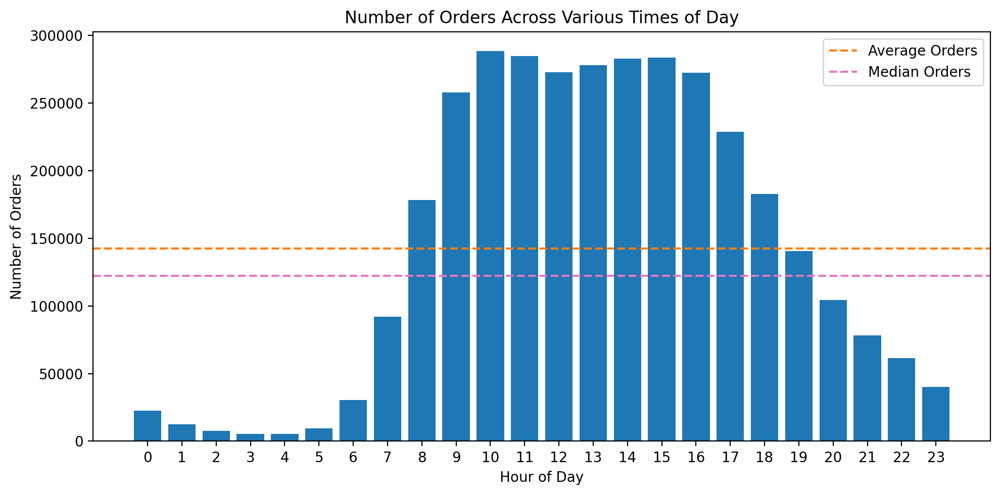

In [14]:
orders_per_hour = df_orders.order_hour_of_day.value_counts()

# Sorting the index to have a sequential x-axis
orders_per_hour = orders_per_hour.sort_index()

# Calculate the average and median
avg_orders = orders_per_hour.values.mean()
median_orders = np.median(orders_per_hour.values)

# Creating the bar chart
plt.figure(figsize=(10, 5), dpi=200)
plt.bar(orders_per_hour.index,
        orders_per_hour.values,
       )

# Adding the average and median lines
plt.axhline(avg_orders, color='tab:orange', linestyle='--', label='Average Orders')
plt.axhline(median_orders, color='tab:pink', linestyle='--', label='Median Orders')

# Adding titles and labels
plt.title('Number of Orders Across Various Times of Day')
plt.xlabel('Hour of Day')
plt.ylabel('Number of Orders')
plt.xticks(list(range(24)))  # Ensure all hours are shown on the x-axis
plt.legend()

# Display the chart
plt.tight_layout()
plt.show()

* Most orders are made from 8 a.m. till 19 p.m.
* Order volumes reach their peak between 10 a.m. and 4 p.m.

### How many orders are made at different days of the week?

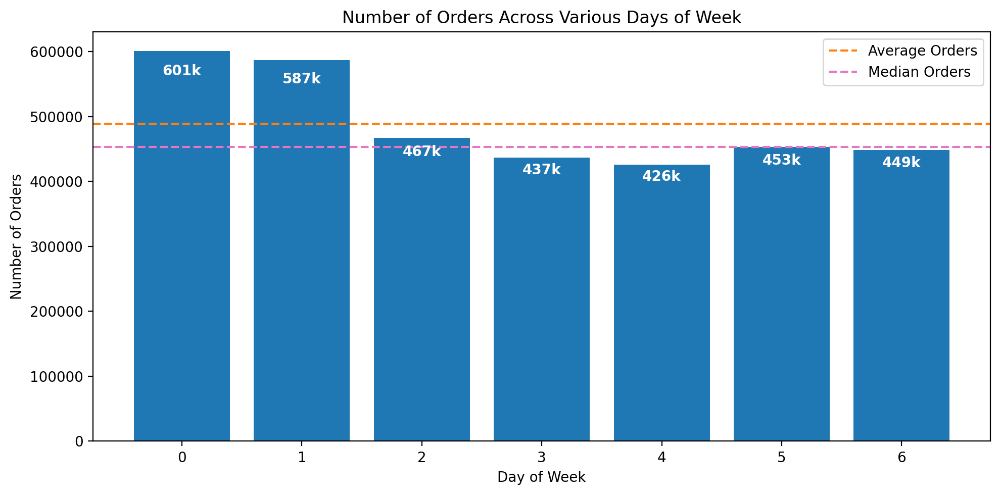

In [15]:
orders_per_day = df_orders.order_dow.value_counts()

# Sorting the index to have a sequential x-axis
orders_per_day = orders_per_day.sort_index()

# Calculate the average and median
avg_orders_day = orders_per_day.values.mean()
median_orders_day = np.median(orders_per_day.values)

# Function to format the values
def format_value(value):
    return "{:.0f}k".format(value/1000) if value >= 1000 else str(value)

# Creating the bar chart
plt.figure(figsize=(10, 5), dpi=200)
bars = plt.bar(orders_per_day.index,
               orders_per_day.values,
              )

# Adding the average and median lines
plt.axhline(avg_orders_day, color='tab:orange', linestyle='--', label='Average Orders')
plt.axhline(median_orders_day, color='tab:pink', linestyle='--', label='Median Orders')

# Displaying the value of each bar inside the bar
for bar in bars:
    yval = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2, yval - 0.07 * yval, format_value(yval), ha='center', va='bottom', color='white', fontweight='bold')

# Adding titles and labels
plt.title('Number of Orders Across Various Days of Week')
plt.xlabel('Day of Week')
plt.ylabel('Number of Orders')
plt.xticks(list(range(7)))  # Ensure all hours are shown on the x-axis
plt.legend()

# Display the chart
plt.tight_layout()
plt.show()

Days 0 and 1 are the most popular days for shopping by users.

Let's check the hourly trend by each day of the week.

In [16]:
day_hour = df_orders.groupby(['order_dow', 'order_hour_of_day']).order_id.count().reset_index()
day_hour = day_hour.rename(columns={'order_id': 'number_of_orders'})

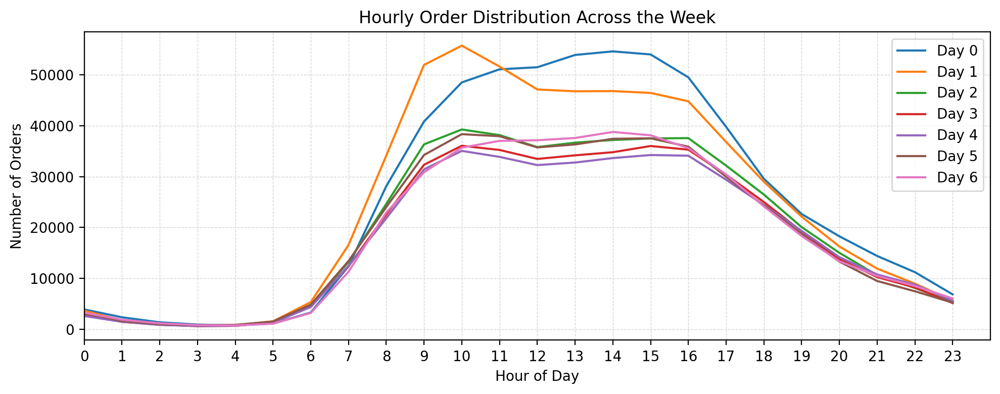

In [17]:
plt.figure(figsize=(10, 4), dpi=200)

for day in range(7):
    subset = day_hour[day_hour['order_dow'] == day]
    plt.plot(subset['order_hour_of_day'], subset['number_of_orders'], label=f'Day {day}')

plt.title('Hourly Order Distribution Across the Week')
plt.xlabel('Hour of Day')
plt.ylabel('Number of Orders')
plt.legend()
plt.grid(True, which='both', linestyle='--', linewidth=0.5, color='lightgrey')
plt.xticks(list(range(24)))
plt.xlim(0, 24)
plt.tight_layout()
plt.show()

* On days 0 and 1, contrasting trends emerge. On day 1, orders predominantly occur in the morning, between 8 a.m. and 12 p.m. In contrast, on day 0, most orders are placed in the afternoon, specifically from 12 p.m. to 4 p.m.
* Day 6 has similar trend with day 0, however the number of orders are much lower.
* Hourly trends for the rest days of week are quite similar.

In accordance with the observations above, looks like day 0 is Sunday, day 1 is Monday, ..., day 6 is Saturday:
* Users start order from Sunday afternoon till Monday afternoon more actively compared to the rest of week. Such a behavour might be explained by the desire to stock up on groceries after the weekend.
* This also corresponds with the fact that a week in the US starts from Sunday.

### After how many days do people order again?

In [18]:
df_orders.days_since_prior_order.describe()

count   3,214,874.00
mean           11.11
std             9.21
min             0.00
25%             4.00
50%             7.00
75%            15.00
max            30.00
Name: days_since_prior_order, dtype: float64

* On average (median) people order again in 7 days (once per week) and maximum after 30 days from the last order.
* The minimum value is 0 (indicating NaN values), signifying an absence of order history. The value after 0 will better describe the minimum days before ordering again.

Let's find the minimum days before ordering again.

In [19]:
df_orders[df_orders.days_since_prior_order > 0].sort_values(by='days_since_prior_order', ascending=True)[:3]

,order_id,user_id,eval_set,order_number,order_dow,order_hour_of_day,days_since_prior_order
1218616,2322872,73266,prior,6,6,20,1.00
2156453,78576,129712,prior,37,2,9,1.00
330278,1511763,20001,prior,90,5,12,1.00


Thus, part of users needs minimum 1 day to reorder. In case of high order frequency this small time gap between orders can help to identify Instacart's heavy users.

### How many users in the dataset placed their initial order?

In [20]:
new_users = df_orders.isna().days_since_prior_order.sum()
nu_share = new_users / df_orders.days_since_prior_order.count() * 100
print(f'There are {new_users} new users. Initial orders are {nu_share:.2}% of all orders.')

There are 206209 new users. Initial orders are 6.4% of all orders.


It appears that this dataset portrays sales data about users from the start of their shopping history on the platform, wherein the new user count precisely matches the total user count of 206,209.

### How many products were sold

In [21]:
prior_train_orders = pd.concat([df_orders_prior, df_orders_train], ignore_index=True)
orders_products1 = pd.merge(prior_train_orders, df_products, on='product_id')
orders_products2 = pd.merge(orders_products1, df_aisles, on='aisle_id')
orders_products_df = pd.merge(orders_products2, df_departments, on='department_id')
orders_products_df[:5]

,order_id,product_id,add_to_cart_order,reordered,product_name,aisle_id,department_id,aisle,department
0,2,33120,1,1,Organic Egg Whites,86,16,eggs,dairy eggs
1,26,33120,5,0,Organic Egg Whites,86,16,eggs,dairy eggs
2,120,33120,13,0,Organic Egg Whites,86,16,eggs,dairy eggs
3,327,33120,5,1,Organic Egg Whites,86,16,eggs,dairy eggs
4,390,33120,28,1,Organic Egg Whites,86,16,eggs,dairy eggs


In [22]:
orders_products_df.shape

(33819106, 9)

Users bought around 34 million products on the platform.

**Note:** As was mentioned above, 75,000 orders from the test evaluation set are not taken into account. There is no data about the products that were ordered in these orders. Thus, sales might be over 34 million products.

### How many items do people buy?

In [23]:
# Calculating the number of products per order
products_in_order = orders_products_df.groupby('order_id').agg({'product_id': pd.Series.count})
products_in_order.rename(columns={'product_id':'products_count'}, inplace=True)

In [24]:
products_in_order.describe()

,products_count
count,"3,346,083.00"
mean,10.11
std,7.54
min,1.00
25%,5.00
50%,8.00
75%,14.00
max,145.00


* On average (median) people buy 8 products per order.
* They buy at least 1 product, and maximum 145 products.
* 75% of the orders has less than 14 products per order. This means the order with 145 products might be an outlier. Further investigation is needed.

In [25]:
products_in_order[products_in_order.products_count > 100].count()

products_count    20
dtype: int64

Only 20 orders out of ~3.3 million have more than 100 products in an order. We can consider these orders as outliers.

### What are the best selling items?

In [26]:
products_count = orders_products_df.groupby('product_id').agg({'product_name': pd.Series.count})
products_count.rename(columns={'product_name':'product_count'}, inplace=True)

products_sold = pd.merge(products_count, df_products, on='product_id')
products_ranged = products_sold.sort_values('product_count', ascending=False)
top_products = products_ranged[:25]
top_products = top_products.sort_values('product_count', ascending=True)

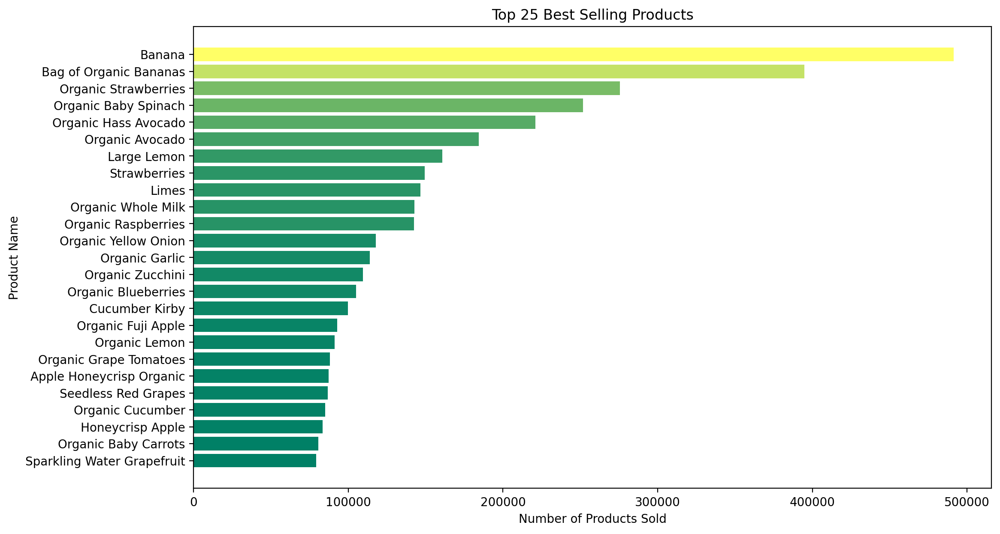

In [27]:
plt.figure(figsize=(12,7), dpi=200)

# Normalize the data and apply colormap
norm = plt.Normalize(min(top_products.product_count), max(top_products.product_count))
colors = cm.summer(norm(top_products.product_count))

plt.barh(top_products.product_name,
         top_products.product_count,
         color=colors)

plt.title('Top 25 Best Selling Products')
plt.ylabel('Product Name')
plt.xlabel('Number of Products Sold')

plt.show()

### What items are most frequently re-ordered?

In many cases, businesses use inventory management systems to track the availability of products and trigger reorder purchases automatically when stock levels fall below a certain threshold. This helps maintain a smooth supply chain and prevents interruptions in the availability of products or materials.

In [28]:
reordered_prods = orders_products_df.groupby('product_name').agg({'reordered': pd.Series.sum})
reordered_prods = reordered_prods[reordered_prods.reordered > 0].sort_values('reordered', ascending=False)
reordered_prods[:3]

,reordered
product_name,
Banana,415166
Bag of Organic Bananas,329275
Organic Strawberries,214448


In [29]:
top_reordered = reordered_prods[:25]
top_reordered = top_reordered.sort_values('reordered', ascending=True)

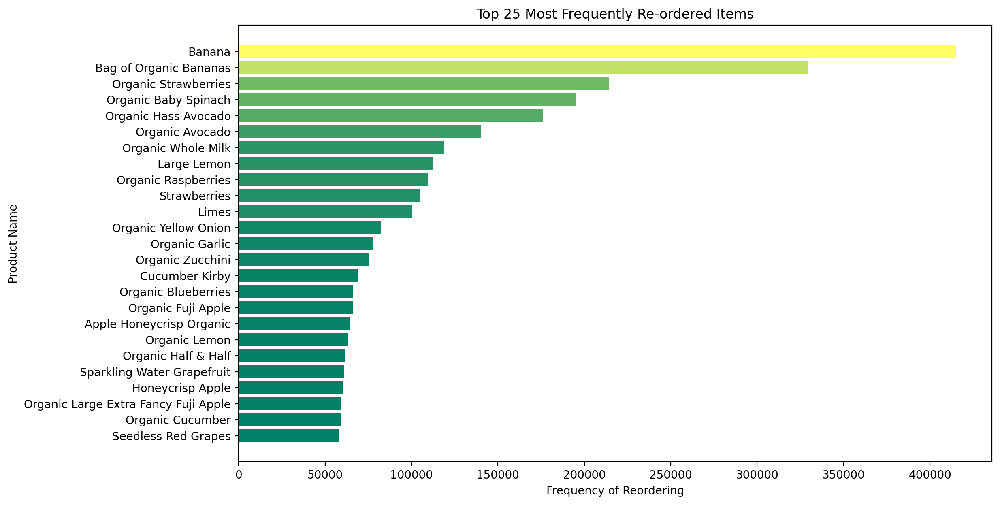

In [30]:
plt.figure(figsize=(12,7), dpi=200)

# Normalize the data and apply colormap
norm = plt.Normalize(min(top_reordered.reordered), max(top_reordered.reordered))
colors = cm.summer(norm(top_reordered.reordered))

plt.barh(top_reordered.index,
         top_reordered.reordered,
         color=colors)

plt.title('Top 25 Most Frequently Re-ordered Items')
plt.ylabel('Product Name')
plt.xlabel('Frequency of Reordering')

plt.show()

### Which items are part into a cart first? second? third?

#### Creating DataFrames containing the top 20 products ordered in the first queue

In [31]:
# Items which are part into a cart firstly
df_ordered_first = orders_products_df[orders_products_df.add_to_cart_order == 1]
order_1 = df_ordered_first.groupby('product_name').agg({'add_to_cart_order': pd.Series.count}).sort_values('add_to_cart_order', ascending=False)
top_order_1 = order_1[:20]
top_order_1 = top_order_1.sort_values('add_to_cart_order', ascending=True)
top_order_1[:3] # check the DataFrame

,add_to_cart_order
product_name,
Raspberries,9320
Organic Reduced Fat 2% Milk,9644
Half & Half,9847


In [32]:
# Items which are part into a cart secondly
df_ordered_second = orders_products_df[orders_products_df.add_to_cart_order == 2]
order_2 = df_ordered_second.groupby('product_name').agg({'add_to_cart_order': pd.Series.count}).sort_values('add_to_cart_order', ascending=False)
top_order_2 = order_2[:20]
top_order_2 = top_order_2.sort_values('add_to_cart_order', ascending=True)
top_order_2[:3] # check the DataFrame

,add_to_cart_order
product_name,
Raspberries,9237
Half & Half,9510
Organic Yellow Onion,9780


In [33]:
# Items which are part into a cart thirdly
df_ordered_third = orders_products_df[orders_products_df.add_to_cart_order == 3]
order_3 = df_ordered_third.groupby('product_name').agg({'add_to_cart_order': pd.Series.count}).sort_values('add_to_cart_order', ascending=False)
top_order_3 = order_3[:20]
top_order_3 = top_order_3.sort_values('add_to_cart_order', ascending=True)
top_order_3[:3] # check the DataFrame

,add_to_cart_order
product_name,
Apple Honeycrisp Organic,8422
Sparkling Water Grapefruit,8615
Honeycrisp Apple,8712


#### Merging 3 DFs while ensuring no products are not lost

In [34]:
# Rename columns to identify the source DataFrame
top_order_1['Firstly'] = top_order_1['add_to_cart_order']
top_order_2['Secondly'] = top_order_2['add_to_cart_order']
top_order_3['Thirdly'] = top_order_3['add_to_cart_order']

# Merge the DataFrames using outer join
top_prods_123 = pd.merge(top_order_1, top_order_2, how='outer', on='product_name')
top_prods_123 = pd.merge(top_prods_123, top_order_3, how='outer', on='product_name')

# Fill NaN values with 0
top_prods_123 = top_prods_123.fillna(0)

# Drop the original columns
top_prods_123 = top_prods_123.drop(['add_to_cart_order', 'add_to_cart_order_x', 'add_to_cart_order_y'], axis=1)

In [35]:
# Create a copy of the merged DataFrame and sort it by the total units sold
sorted_top_prods = top_prods_123.copy()
sorted_top_prods['Total'] = sorted_top_prods['Firstly'] + sorted_top_prods['Secondly'] + sorted_top_prods['Thirdly']
sorted_top_prods = sorted_top_prods.sort_values(by='Total', ascending=True)

In [36]:
bar_split = px.bar(sorted_top_prods,
                   x=['Firstly', 'Secondly', 'Thirdly'],
                   y=sorted_top_prods.index,
                   labels={'value': 'Units Sold', 'product_name': 'Product', 'variable': 'Added to cart:'},
                   title='Products Added to Cart Initially, Subsequently, and Thirdly',
                   color_discrete_sequence=px.colors.qualitative.T10,
                  )

bar_split.update_layout(yaxis_tickfont=dict(size=10),
                        title_font=dict(size=20),
                       )
bar_split.show()

## How often are products from the department/aisle sold?

In [37]:
products_with_dept = pd.merge(products_sold, df_departments, on='department_id')
depts_ranged = products_with_dept.groupby('department').agg({'product_count': pd.Series.sum}).sort_values('product_count',
                                                                                                          ascending=False)
depts_ranged[:3]

,product_count
department,
produce,9888378
dairy eggs,5631067
snacks,3006412


In [38]:
donut = px.pie(depts_ranged,
               names=depts_ranged.index,
               values='product_count',
               title='Orders by Department',
               hole=0.5,
               color_discrete_sequence=px.colors.qualitative.T10,
              )

donut.show()

Based on the department's share of the total number of orders, we can categorize them into four distinct groups:

**Group 1 - Top departments (~46%)**
* The largest department, comprising nearly 30% of all orders, is the produce department, which includes aisles such as fresh fruits and vegetables.
* The second most significant department, dairy eggs, is approximately half the size of the #1 department.
* Both produce and dairy eggs are top-priority departments on the platform.  Products from these departments are the best sellers, are frequently reordered and added to cart initially, subsequently, and thirdly.

**Group 2 - Important departments (~30%)**
* Snacks, beverages, frozen and pantry goods each account for a similar percentage of orders, ranging from 5% to 10% of all orders.

These two groups of departments generate **76%** of all sales on the platform and should be in the **primary focus** of further investigation.

**Group 3 - Small departments (~20%)**
* The following departments fall into this category, representing between 2% and 5% of orders each: bakery, canned goods, deli, dry goods, pasta, household, meat seafood and breakfast. Although smaller in scale, these departments may still hold significance for our users.

**Group 4 - Other (~4%)**
* The remaining departments, such as personal care, baby products, international items, alcohol, and pet supplies, each contribute to less than 1.5% of total sales. Given their minimal impact on overall sales, this group is not a primary focus for further research.

In [39]:
prod_aisle_dept = pd.merge(products_with_dept, df_aisles, on='aisle_id')
prod_aisle_dept[:3] # check the DataFrame

,product_id,product_count,product_name,aisle_id,department_id,department,aisle
0,1,1928,Chocolate Sandwich Cookies,61,19,snacks,cookies cakes
1,78,12,Nutter Butter Cookie Bites Go-Pak,61,19,snacks,cookies cakes
2,102,190,Danish Butter Cookies,61,19,snacks,cookies cakes


In [40]:
fig = px.treemap(prod_aisle_dept, path=['department', 'aisle', 'product_name'], values='product_count',
                 color_discrete_sequence=px.colors.qualitative.T10,
                )

fig.update_layout(title='Interactive Tree Map: Department -> Aisle -> Product')

fig.show()

In [41]:
aisle_counts = prod_aisle_dept.groupby('aisle')['product_count'].sum().reset_index()
aisle_counts.head()

,aisle,product_count
0,air fresheners candles,20918
1,asian foods,173614
2,baby accessories,8466
3,baby bath body care,8909
4,baby food formula,395654


In [42]:
# Determine the department for each aisle
aisle_department = prod_aisle_dept.groupby('aisle')['department'].agg(pd.Series.mode).reset_index()

In [43]:
# Merge the two DataFrames
aisle_dept = pd.merge(aisle_counts, aisle_department, on='aisle').sort_values(by='product_count', ascending=False)
aisle_dept.head()

,aisle,product_count,department
50,fresh fruits,3792661,produce
53,fresh vegetables,3568630,produce
98,packaged vegetables fruits,1843806,produce
133,yogurt,1507583,dairy eggs
93,packaged cheese,1021462,dairy eggs


In [44]:
# Find the top aisles
top_aisles = aisle_dept.nlargest(25, 'product_count')['aisle'].tolist()

# Create a new column that either has the aisle name or 'other_aisles'
aisle_dept['aisle_grouped'] = aisle_dept['aisle'].apply(lambda x: x if x in top_aisles else 'other aisles')

In [45]:
top_aisles = aisle_dept.nlargest(25, 'product_count')

In [46]:
fig = px.bar(top_aisles,
             x='product_count',
             y='aisle',
             color='department', 
             color_discrete_sequence=px.colors.qualitative.T10,
             orientation='h',
             title="Top 25 Aisles",
            )

fig.update_layout(yaxis=dict(tickfont=dict(size=9)))

fig.update_layout(
    title_font=dict(size=20),
    xaxis_title="Products Ordered",
    yaxis_title="Aisle",
    yaxis_categoryorder='total ascending',
    xaxis=dict(titlefont=dict(size=14)),
    yaxis=dict(titlefont=dict(size=14)),
)

fig.show()

## Which aisles are more likely to be reordered from?

In [47]:
orders_products_df.head()

,order_id,product_id,add_to_cart_order,reordered,product_name,aisle_id,department_id,aisle,department
0,2,33120,1,1,Organic Egg Whites,86,16,eggs,dairy eggs
1,26,33120,5,0,Organic Egg Whites,86,16,eggs,dairy eggs
2,120,33120,13,0,Organic Egg Whites,86,16,eggs,dairy eggs
3,327,33120,5,1,Organic Egg Whites,86,16,eggs,dairy eggs
4,390,33120,28,1,Organic Egg Whites,86,16,eggs,dairy eggs


In [48]:
# Calculate total purchases
total_aisle = orders_products_df.groupby('aisle')['reordered'].count().reset_index()
total_aisle.rename(columns={'reordered': 'total_purchases'}, inplace=True)

# Calculate purchases with reordered products
reodered_aisle = orders_products_df.groupby('aisle')['reordered'].sum().reset_index()

# Create the DataFrame with 'reordered' and 'total_purchases' columns
merged_aisle = pd.merge(total_aisle, reodered_aisle, on='aisle')
merged_aisle['percent_reorder'] = (merged_aisle.reordered / merged_aisle.total_purchases) * 100
merged_aisle.head()

,aisle,total_purchases,reordered,percent_reorder
0,air fresheners candles,20918,6500,31.07
1,asian foods,173614,60986,35.13
2,baby accessories,8466,4669,55.15
3,baby bath body care,8909,2626,29.48
4,baby food formula,395654,233042,58.90


In [49]:
df_deps = orders_products_df[['aisle', 'department']].drop_duplicates()

# Merge the DataFrames using a left merge
dept_aisle_df = merged_aisle.merge(df_deps[['aisle', 'department']], on='aisle', how='left')
dept_aisle_df.head()

,aisle,total_purchases,reordered,percent_reorder,department
0,air fresheners candles,20918,6500,31.07,household
1,asian foods,173614,60986,35.13,international
2,baby accessories,8466,4669,55.15,babies
3,baby bath body care,8909,2626,29.48,babies
4,baby food formula,395654,233042,58.90,babies


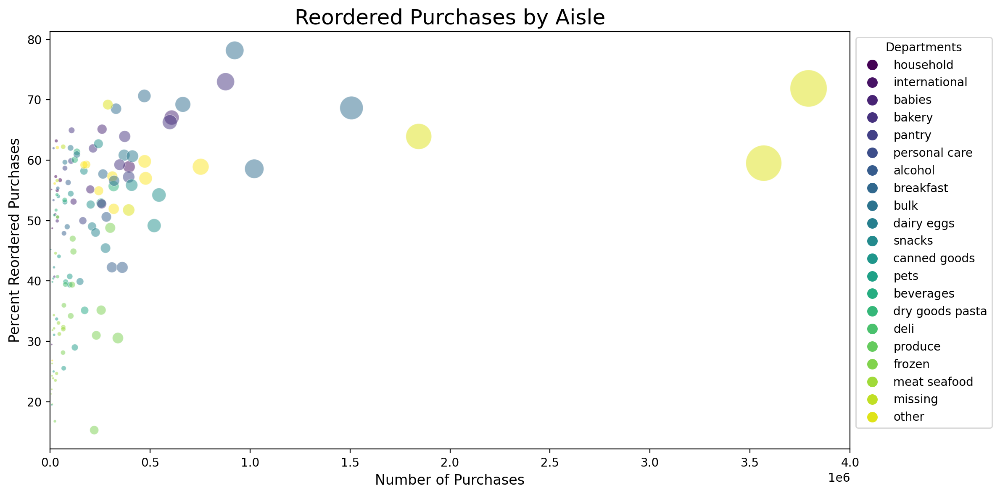

In [50]:
# Convert the 'department' to a categorical type and get the codes
dept_aisle_df['department_codes'] = dept_aisle_df['department'].astype('category').cat.codes

plt.figure(figsize=(12,6), dpi=200)
plt.scatter(dept_aisle_df['total_purchases'],
            dept_aisle_df['percent_reorder'],
            s=dept_aisle_df['total_purchases']/max(dept_aisle_df['total_purchases'])*1000,  # Normalized size
            c=dept_aisle_df['department_codes'],  # Coloring based on the category codes
            alpha=0.5,
            cmap='viridis',
            edgecolors="w",
            linewidth=0.5,
           )

# To display a legend mapping colors to departments
unique_labels = dept_aisle_df['department'].unique()
num_unique = len(unique_labels)

# Create custom legend
colors = [plt.cm.viridis(i/num_unique) for i in range(num_unique)]
legend_elements = [plt.Line2D([0], [0], marker='o', color='w', markerfacecolor=color, markersize=10, label=label) 
                   for color, label in zip(colors, unique_labels)]
legend = plt.legend(handles=legend_elements, title="Departments", loc="upper left", bbox_to_anchor=(1, 1))

plt.xlim([0, 4000000])
plt.xlabel('Number of Purchases', fontsize=12)
plt.ylabel('Percent Reordered Purchases', fontsize=12)
plt.title('Reordered Purchases by Aisle', fontsize=18)

# Adjust layout to make room for the legend
plt.tight_layout()
plt.show()

In [51]:
# Determine a threshold: the 90th percentil
threshold = dept_aisle_df['total_purchases'].quantile(0.90)

# Create a new column for display text
dept_aisle_df['text_display'] = dept_aisle_df.apply(lambda row: row['aisle'] if row['total_purchases'] > threshold else '', axis=1)

fig = px.scatter(dept_aisle_df,
                 x='total_purchases',
                 y='percent_reorder',
                 size='total_purchases',
                 color='department',
                 color_discrete_sequence=px.colors.qualitative.T10,
                 text='text_display',
                 hover_name='aisle',
                )

fig.update_traces(textposition='top center')
fig.update_xaxes(title_text='Number of Purchases', range=[0, 4000000],)
fig.update_yaxes(title_text='Percent Reordered Purchases')
fig.update_layout(title='Reordered Purchases by Aisle', title_font=dict(size=20))
fig.show()

## When during the day popular products are ordered?

In [52]:
merged_df = pd.merge(orders_products_df, df_orders, on='order_id')
merged_df.head() # Check a DataFrame

,order_id,product_id,add_to_cart_order,reordered,product_name,aisle_id,department_id,aisle,department,user_id,eval_set,order_number,order_dow,order_hour_of_day,days_since_prior_order
0,2,33120,1,1,Organic Egg Whites,86,16,eggs,dairy eggs,202279,prior,3,5,9,8.00
1,2,28985,2,1,Michigan Organic Kale,83,4,fresh vegetables,produce,202279,prior,3,5,9,8.00
2,2,17794,6,1,Carrots,83,4,fresh vegetables,produce,202279,prior,3,5,9,8.00
3,2,43668,9,0,Classic Blend Cole Slaw,123,4,packaged vegetables fruits,produce,202279,prior,3,5,9,8.00
4,2,9327,3,0,Garlic Powder,104,13,spices seasonings,pantry,202279,prior,3,5,9,8.00


### Orders by department during the day

In [53]:
depts_list = merged_df.groupby('department').size().index
depts_list

Index(['alcohol', 'babies', 'bakery', 'beverages', 'breakfast', 'bulk',
       'canned goods', 'dairy eggs', 'deli', 'dry goods pasta', 'frozen',
       'household', 'international', 'meat seafood', 'missing', 'other',
       'pantry', 'personal care', 'pets', 'produce', 'snacks'],
      dtype='object', name='department')

In [54]:
agg_depts_day = (merged_df.groupby(['department', 'order_hour_of_day'])
                 .size()
                 .reset_index(name='hour_sales')
                 .sort_values('order_hour_of_day', ascending=False))
agg_depts_day[:3] # Check a DataFrame

,department,order_hour_of_day,hour_sales
503,snacks,23,34710
431,personal care,23,5576
287,household,23,9028


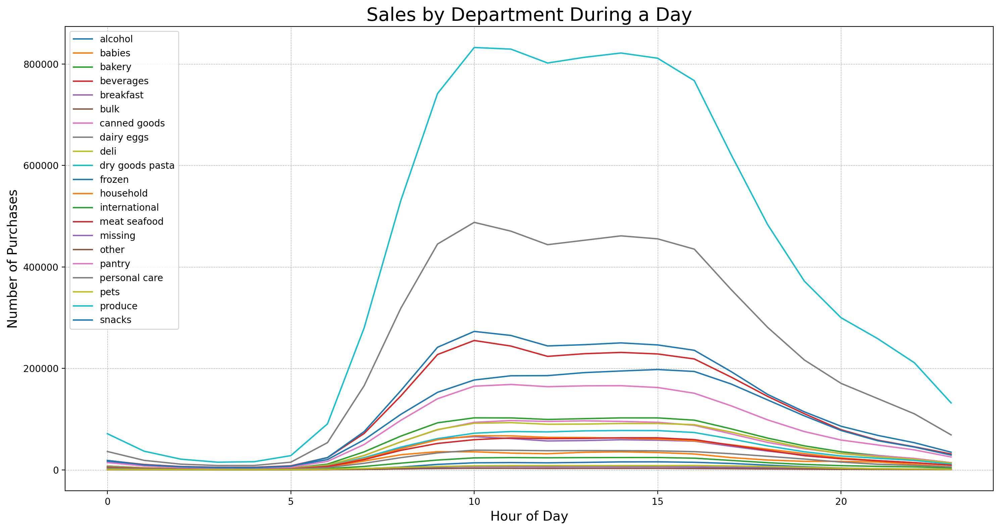

In [55]:
plt.figure(figsize=(15,8), dpi=200)
for dept in depts_list:
    subset = agg_depts_day[agg_depts_day['department'] == dept]
    plt.plot(subset['order_hour_of_day'], subset['hour_sales'], label=dept)

plt.legend(loc="upper left")

plt.title('Sales by Department During a Day', fontsize=20)
plt.xlabel('Hour of Day', fontsize=14)
plt.ylabel('Number of Purchases', fontsize=14)
plt.grid(True, which='both', linestyle='--', linewidth=0.5)
plt.tight_layout()
plt.show()

The trend for 15+ departments is ambiguous; normalisation is needed. Let's attempt to substitute the number of purchases with the percentage of orders (where the total orders for a department in a day equals 100%).

In [56]:
# Calculate total sales per department and percent of orders 
agg_depts_day['total_sales'] = agg_depts_day.groupby('department')['hour_sales'].transform('sum')
agg_depts_day['percent_of_orders'] = (agg_depts_day['hour_sales'] / agg_depts_day['total_sales']) * 100

agg_depts_day[:3] # Check a DataFrame

,department,order_hour_of_day,hour_sales,total_sales,percent_of_orders
503,snacks,23,34710,3006412,1.15
431,personal care,23,5576,468693,1.19
287,household,23,9028,774652,1.17


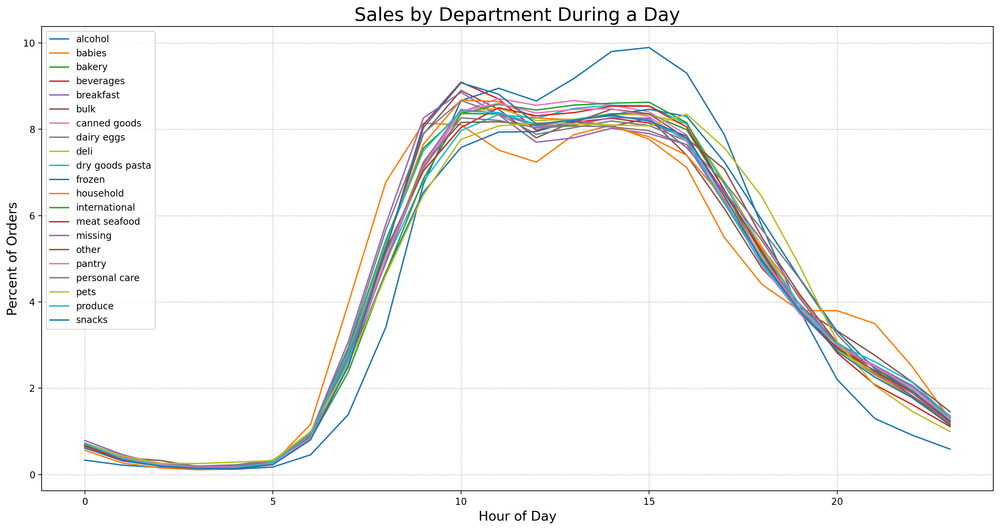

In [57]:
plt.figure(figsize=(15,8), dpi=200)
for dept in depts_list:
    subset = agg_depts_day[agg_depts_day['department'] == dept]
    plt.plot(subset['order_hour_of_day'], subset['percent_of_orders'], label=dept)

plt.legend(loc="upper left")

plt.title('Sales by Department During a Day', fontsize=20)
plt.xlabel('Hour of Day', fontsize=14)
plt.ylabel('Percent of Orders', fontsize=14)
plt.grid(True, which='both', linestyle='--', linewidth=0.5)
plt.tight_layout()
plt.show()

#### 2. Orders by aisle during the day

In [58]:
aisles_list = merged_df.groupby('aisle').size().index
aisles_list

Index(['air fresheners candles', 'asian foods', 'baby accessories',
       'baby bath body care', 'baby food formula', 'bakery desserts',
       'baking ingredients', 'baking supplies decor', 'beauty',
       'beers coolers',
       ...
       'spreads', 'tea', 'tofu meat alternatives', 'tortillas flat bread',
       'trail mix snack mix', 'trash bags liners', 'vitamins supplements',
       'water seltzer sparkling water', 'white wines', 'yogurt'],
      dtype='object', name='aisle', length=134)

In [59]:
agg_aisles_day = (merged_df.groupby(['aisle', 'order_hour_of_day'])
                 .size()
                 .reset_index(name='hour_sales')
                 .sort_values('order_hour_of_day', ascending=False))

# Calculate total sales per aisle and percent of orders 
agg_aisles_day['total_sales'] = agg_aisles_day.groupby('aisle')['hour_sales'].transform('sum')
agg_aisles_day['percent_of_orders'] = (agg_aisles_day['hour_sales'] / agg_aisles_day['total_sales']) * 100

agg_aisles_day.head() # Check the DataFrame

,aisle,order_hour_of_day,hour_sales,total_sales,percent_of_orders
3215,yogurt,23,19461,1507583,1.29
2495,popcorn jerky,23,1789,170441,1.05
2447,pickled goods olives,23,1566,117521,1.33
3143,vitamins supplements,23,611,47028,1.30
3095,trail mix snack mix,23,331,37053,0.89


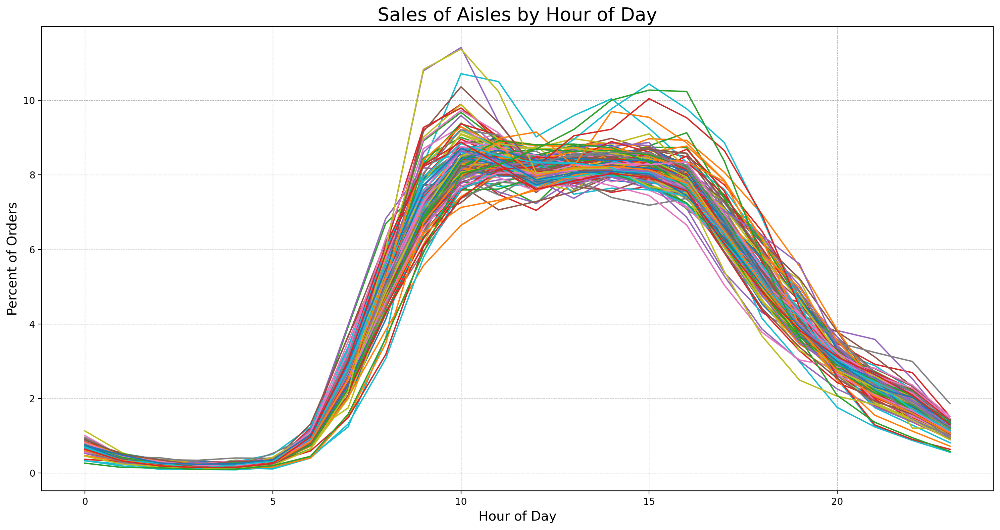

In [60]:
plt.figure(figsize=(15,8), dpi=200)
for aisle in aisles_list:
    subset = agg_aisles_day[agg_aisles_day['aisle'] == aisle]
    plt.plot(subset['order_hour_of_day'], subset['percent_of_orders'], label=aisle)

#plt.legend(loc="upper left")

plt.title('Sales of Aisles by Hour of Day', fontsize=20)
plt.xlabel('Hour of Day', fontsize=14)
plt.ylabel('Percent of Orders', fontsize=14)
plt.grid(True, which='both', linestyle='--', linewidth=0.5)
plt.tight_layout()
plt.show()

/Users/nadyavoynich/opt/anaconda3/lib/python3.9/site-packages/sklearn/utils/validation.py:623: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.



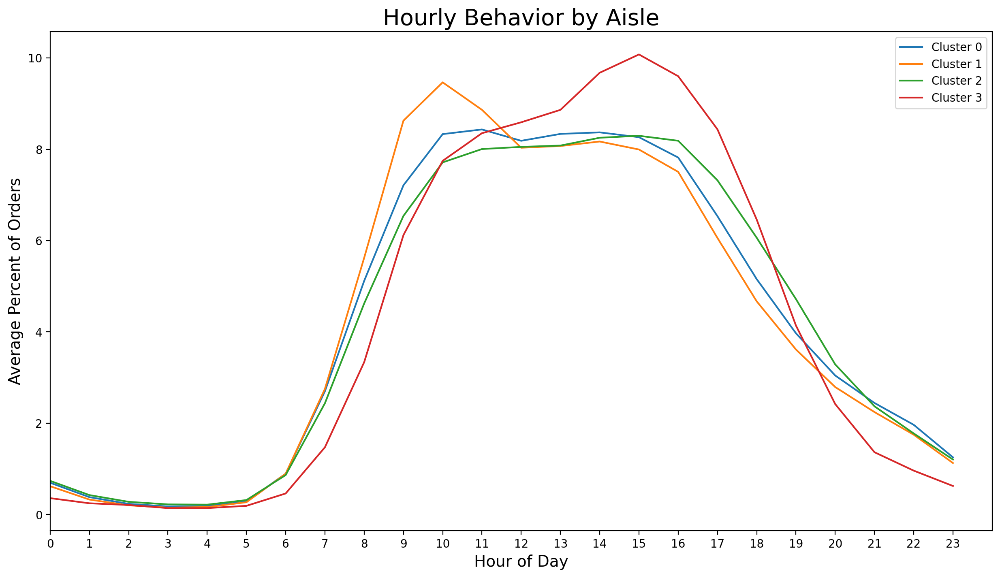

In [61]:
# Prepare data for clustering: Create a pivot table with 'order_hour_of_day' as columns
pivot_df = agg_aisles_day.pivot_table(index='aisle', columns='order_hour_of_day', values='percent_of_orders')

# Clustering aisles based on their hourly patterns
kmeans = KMeans(n_clusters=4, random_state=56)  # Assuming 4 clusters and setting a fixed random seed
clusters = kmeans.fit_predict(pivot_df)

pivot_df['cluster'] = clusters

# Plotting
plt.figure(figsize=(15, 8), dpi=200)

for cluster in pivot_df['cluster'].unique():
    subset = pivot_df[pivot_df['cluster'] == cluster]
    # Calculate the mean percent_of_orders for each hour in this cluster
    mean_percent = subset.mean(axis=0)[:-1]  # Excluding the cluster column from the mean calculation
    plt.plot(mean_percent.index, mean_percent.values, label=f'Cluster {cluster}')

plt.xlim([0, 24])
plt.xticks(np.arange(0, 24, step=1))  # Setting x-axis to show every hour
plt.xlabel('Hour of Day', fontsize=14)
plt.ylabel('Average Percent of Orders', fontsize=14)
plt.title('Hourly Behavior by Aisle', fontsize=20)
plt.legend()
plt.grid(False)
plt.show()

* Aisles in clusters 0 and 2 exhibit contrasting behavior during the morning and afternoon. However, the difference is not dramatically large.
* Products in aisle **cluster 1** tend to be purchased earlier in the day, whereas in **cluster 3** are far more popular when customers are ordering in the evening.

In [62]:
# List the aisles for each cluster:
for cluster in pivot_df['cluster'].unique():
    aisles_in_cluster = pivot_df[pivot_df['cluster'] == cluster].index.tolist()
    print(f"Cluster {cluster} contains the following aisles:")
    for aisle in aisles_in_cluster:
        print(aisle)
    print("\n")

Cluster 0 contains the following aisles:
air fresheners candles
asian foods
baby accessories
baby bath body care
baking ingredients
baking supplies decor
bread
bulk grains rice dried goods
buns rolls
butter
candy chocolate
canned fruit applesauce
canned jarred vegetables
canned meals beans
canned meat seafood
cereal
chips pretzels
condiments
cookies cakes
crackers
diapers wipes
digestion
doughs gelatins bake mixes
dry pasta
eggs
energy sports drinks
feminine care
food storage
fresh dips tapenades
fresh fruits
fresh herbs
fresh vegetables
frozen appetizers sides
frozen breads doughs
frozen breakfast
frozen meat seafood
frozen produce
grains rice dried goods
hot dogs bacon sausage
instant foods
juice nectars
kitchen supplies
kosher foods
latino foods
laundry
lunch meat
marinades meat preparation
meat counter
missing
more household
muscles joints pain relief
oils vinegars
other
other creams cheeses
packaged cheese
packaged meat
packaged poultry
packaged seafood
packaged vegetables fruits


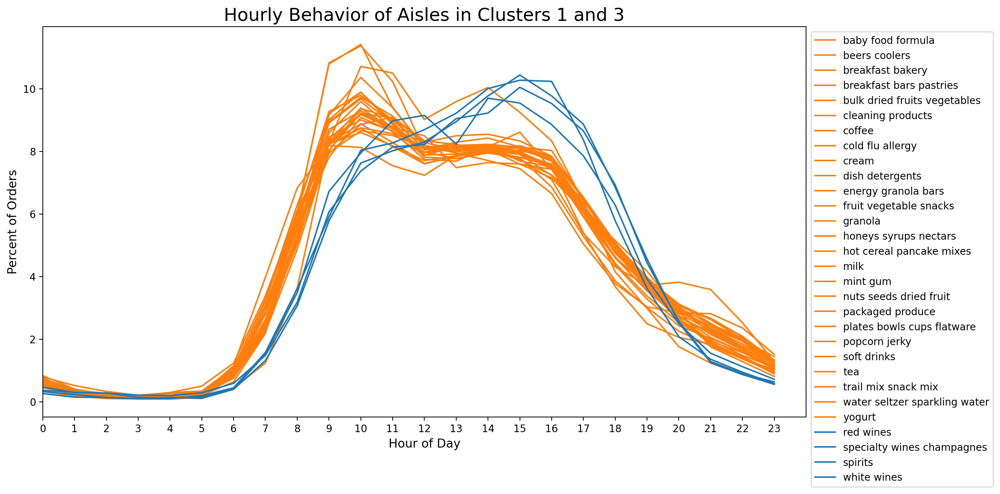

In [63]:
# Define colors for the clusters
color_map = {1: 'tab:orange', 3: 'tab:blue'}

# Plotting
plt.figure(figsize=(14, 7), dpi=200)

# Plotting aisles in clusters 1 and 3
for cluster, color in color_map.items():
    subset = pivot_df[pivot_df['cluster'] == cluster]
    for _, row in subset.iterrows():
        plt.plot(row.index[:-1], row.values[:-1], label=row.name, color=color)

plt.xlim([0, 24])
plt.xticks(np.arange(0, 24, step=1))  # Setting x-axis to show every hour
plt.xlabel('Hour of Day', fontsize=12)
plt.ylabel('Percent of Orders', fontsize=12)
plt.title('Hourly Behavior of Aisles in Clusters 1 and 3', fontsize=18)
plt.legend(loc='upper left', bbox_to_anchor=(1,1), ncol=1)  # Adjust legend location and layout for better visibility
plt.grid(False)
plt.tight_layout()
plt.show()

## How Many Products People Buy Since a Previous Order?

In [68]:
merged_df.head()

,order_id,product_id,add_to_cart_order,reordered,product_name,aisle_id,department_id,aisle,department,user_id,eval_set,order_number,order_dow,order_hour_of_day,days_since_prior_order
0,2,33120,1,1,Organic Egg Whites,86,16,eggs,dairy eggs,202279,prior,3,5,9,8.00
1,2,28985,2,1,Michigan Organic Kale,83,4,fresh vegetables,produce,202279,prior,3,5,9,8.00
2,2,17794,6,1,Carrots,83,4,fresh vegetables,produce,202279,prior,3,5,9,8.00
3,2,43668,9,0,Classic Blend Cole Slaw,123,4,packaged vegetables fruits,produce,202279,prior,3,5,9,8.00
4,2,9327,3,0,Garlic Powder,104,13,spices seasonings,pantry,202279,prior,3,5,9,8.00


In [69]:
# Calculate the number of products per order
products_per_order = merged_df.groupby('order_id')['product_name'].count().reset_index(name='num_products')

# Merge this information back to the original dataframe
df_merged = merged_df.merge(products_per_order, on='order_id')

# Calculate the average number of products per days_since_prior_order value
avg_products = df_merged.groupby('days_since_prior_order')['num_products'].mean().reset_index()
median_products = df_merged.groupby('days_since_prior_order')['num_products'].median().reset_index()
median_products.head()

,days_since_prior_order,num_products
0,0.00,10.00
1,1.00,9.00
2,2.00,10.00
3,3.00,12.00
4,4.00,13.00


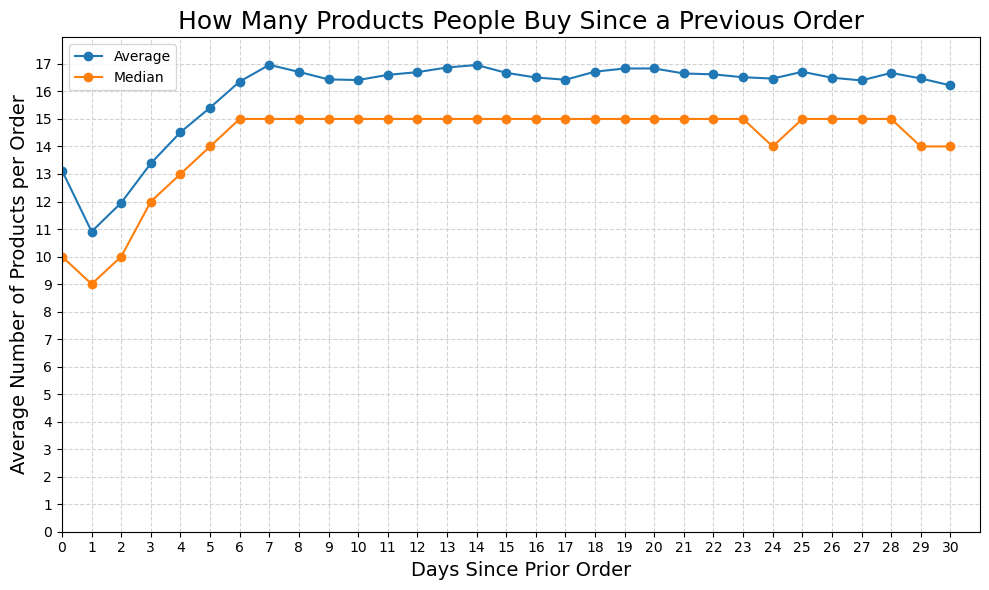

In [74]:
# Plot the data
plt.figure(figsize=(10,6))
plt.plot(avg_products['days_since_prior_order'], avg_products['num_products'], marker='o', label='Average')
plt.plot(median_products['days_since_prior_order'], median_products['num_products'], marker='o', label='Median')
plt.xlabel('Days Since Prior Order', fontsize=14)
plt.ylabel('Average Number of Products per Order', fontsize=14)
plt.title('How Many Products People Buy Since a Previous Order', fontsize=18)
plt.xlim([0, avg_products['days_since_prior_order'].max()+1])
plt.ylim([0, avg_products['num_products'].max()+1])
plt.xticks(np.arange(0, avg_products['days_since_prior_order'].max()+1, step=1))
plt.yticks(np.arange(0, avg_products['num_products'].max()+1, step=1))
plt.grid(True, color='lightgrey', linestyle='--')
plt.tight_layout()
plt.legend(loc='best')

plt.show()

## IV. Findings & Conclusions

### Closing the database connection to free up resources

In [71]:
#connection.close()